# Image Processing

#### Goals
#### Learn various image processing operations
#### Perform image operations such as Smoothing, Blurring, Morphological Operations
#### Grab properties such as color spaces and histograms

In [1]:
# Color Mappngs
# So far we worked with RGB color spaces
# There are some other models like HSL (Hue, Saturation, Lightness) and HSV(Hue, Saturation and Value)
# HSL and HSV are more aligned with human vision actually perceives
# # While in this course we deal with RGB images, its a good idea to understand about HSV and HSL colorspaces

In [2]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/00-puppy.jpg')
plt.imshow(img)

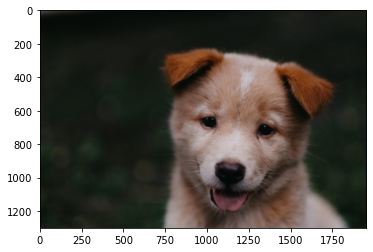

In [3]:
# converting to RGB
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))

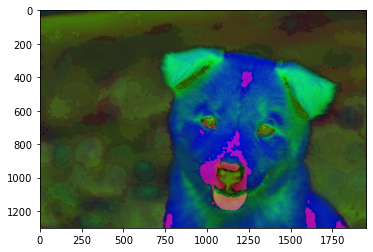

In [4]:
# converting to HSV
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2HSV))

In [5]:
# Blending and Pasting Images
# Blend images
# Formula:
# new_pixel = alpha x pixel_1(1st image) + beta x pixel_2(2nd image) + gamma

In [6]:
img1 = cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/dog_backpack.jpg')
img2 = cv2.cvtColor(cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/watermark_no_copy.png'),cv2.COLOR_BGR2RGB)

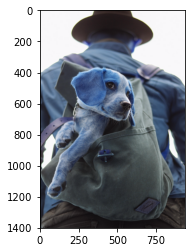

In [7]:
plt.imshow(img1)


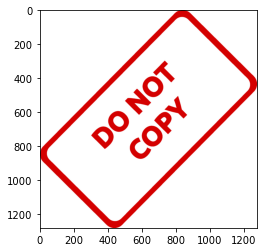

In [8]:
plt.imshow(img2)

In [9]:
print('img1 shape: ',img1.shape)
print('img2 shape: ',img2.shape)
# blending images of same size


img1 shape:  (1401, 934, 3)
img2 shape:  (1280, 1277, 3)


In [10]:
#resize to equal sizes
img1 = cv2.resize(img1,(1200,1200))
img2 = cv2.resize(img2,(1200,1200))

In [11]:
print('img1 shape: ',img1.shape)
print('img2 shape: ',img2.shape)

img1 shape:  (1200, 1200, 3)
img2 shape:  (1200, 1200, 3)


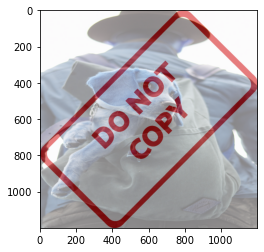

In [12]:
# g(x)=(1−α)f0(x)+αf1(x)

# Alpha blending with OpenCV: cv2.addWeighted()
# Masking with OpenCV: cv2.bitwise_and()
# Alpha blending with NumPy
# Masking with NumPy
# Complex alpha blending and masking with NumPy
# Mask image creation by OpenCV drawing

blended = cv2.addWeighted(src1 = img1,alpha = 0.5,src2 = img2,beta = 0.5,gamma = 0)
plt.imshow(blended)

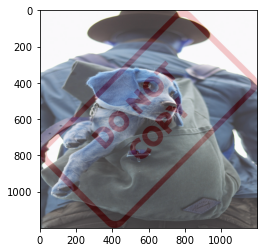

In [13]:
blended = cv2.addWeighted(src1 = img1,alpha = 0.8,
                         src2 = img2,beta = 0.2,gamma = 0)
plt.imshow(blended)

In [14]:
#Overlay small image on top of larger image
#numpy reassignment
img1 = cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/dog_backpack.jpg')
img2 = cv2.cvtColor(cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/watermark_no_copy.png'),cv2.COLOR_BGR2RGB)

In [15]:
img2 = cv2.resize(img2,(600,600)) #img2 is smaller than img1
large_img = img1
small_img = img2
x_offset = 0
y_offset = 0
## in numpy x axis is vertical and y axis is horizontal
x_end = x_offset + small_img.shape[1]
y_end = y_offset + small_img.shape[0]

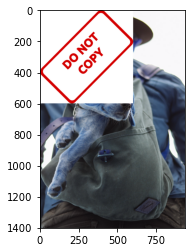

In [16]:
large_img[y_offset:y_end,x_offset:x_end] = small_img
plt.imshow(large_img)

In [17]:
# Blend images of different sizes
img1 = cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/dog_backpack.jpg')
img2 = cv2.cvtColor(cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/watermark_no_copy.png'),cv2.COLOR_BGR2RGB)

In [18]:
img2 = cv2.resize(img2,(600,600)) #img2 is smaller than img1
x_offset = 934 - 600
y_offset = 1401 - 600

In [19]:
img1.shape

(1401, 934, 3)

In [20]:
img2.shape

(600, 600, 3)

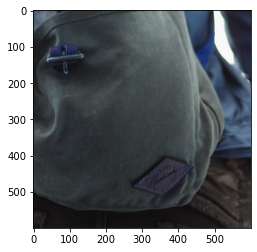

In [21]:
rows,cols,channels = img2.shape
#region of interest
roi = img1[y_offset:1401,x_offset:934]
plt.imshow(roi)

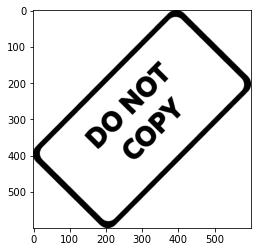

In [22]:
img2gray = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)
plt.imshow(img2gray,cmap = 'gray')

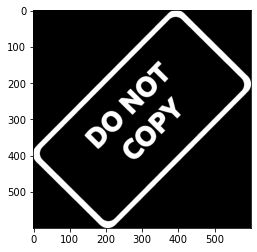

In [23]:
# Syntax: cv2.bitwise_not(source, destination, mask)

# Parameters:
# source: Input Image array(Single-channel, 8-bit or floating-point)
# dest: Output array (Similar to the dimensions and type of Input image array)
# mask: Operation mask, Input / output 8-bit single-channel mask

mask_inv = cv2.bitwise_not(img2gray)
plt.imshow(mask_inv,cmap='gray')

In [24]:
mask_inv.shape


(600, 600)

In [27]:
import numpy as np
#you can see the image is 2D now
white_bgd = np.full(img2.shape,255,dtype=np.uint8)
white_bgd.shape

(600, 600, 3)

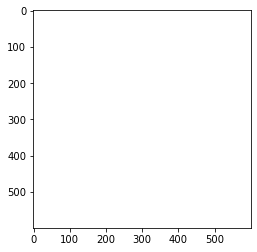

In [28]:
plt.imshow(white_bgd)

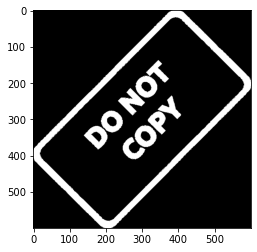

In [29]:
# Bit-wise conjunction of input array elements.
# Syntax: cv2.bitwise_and(source1, source2, destination, mask)

# Parameters:
# source1: First Input Image array(Single-channel, 8-bit or floating-point)
# source2: Second Input Image array(Single-channel, 8-bit or floating-point)
# dest: Output array (Similar to the dimensions and type of Input image array)
# mask: Operation mask, Input / output 8-bit single-channel mask



# Bit-wise disjunction of input array elements.
# Syntax: cv2.bitwise_or(source1, source2, destination, mask)

# Parameters:
# source1: First Input Image array(Single-channel, 8-bit or floating-point)
# source2: Second Input Image array(Single-channel, 8-bit or floating-point)
# dest: Output array (Similar to the dimensions and type of Input image array)
# mask: Operation mask, Input / output 8-bit single-channel mask

bk = cv2.bitwise_or(white_bgd,white_bgd,mask=mask_inv)
plt.imshow(bk)

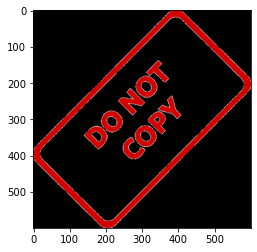

In [30]:
# Syntax: cv2.bitwise_or(source1, source2, destination, mask)

# Parameters:
# source1: First Input Image array(Single-channel, 8-bit or floating-point)
# source2: Second Input Image array(Single-channel, 8-bit or floating-point)
# dest: Output array (Similar to the dimensions and type of Input image array)
# mask: Operation mask, Input / output 8-bit single-channel mask

fg = cv2.bitwise_or(img2,img2,mask = mask_inv)
plt.imshow(fg)

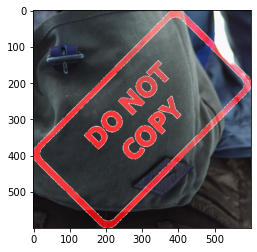

In [31]:
# Syntax: cv2.bitwise_or(source1, source2, destination, mask)

# Parameters:
# source1: First Input Image array(Single-channel, 8-bit or floating-point)
# source2: Second Input Image array(Single-channel, 8-bit or floating-point)
# dest: Output array (Similar to the dimensions and type of Input image array)
# mask: Operation mask, Input / output 8-bit single-channel mask

final_roi = cv2.bitwise_or(roi,fg)
plt.imshow(final_roi)

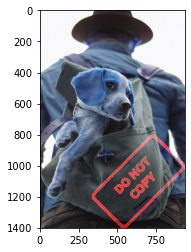

In [32]:
large_img = img1
small_img = final_roi
large_img[y_offset:y_offset+small_img.shape[0],
         x_offset:x_offset+small_img.shape[1]] = small_img
plt.imshow(large_img)

In [33]:
# Class 3 Image Threshodling
# Thresholding is fundamentally a very simple method of segmenting an image into different parts
# Threshodling will convert an image to white or black

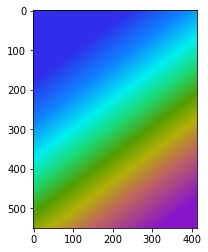

In [34]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/rainbow.jpg')
plt.imshow(img)

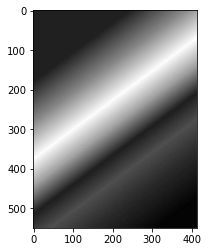

In [35]:
#read as grayscale
img_gray = cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/rainbow.jpg',0)
plt.imshow(img_gray,cmap='gray')

#### Threshold types

In [36]:
ret,thresh1 = cv2.threshold(img_gray,thresh=img.max()/2,maxval = 255,
             type = cv2.THRESH_BINARY)
ret

127.0

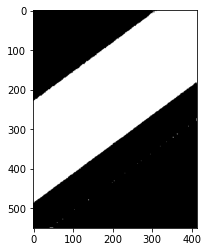

In [37]:
plt.imshow(thresh1,cmap = 'gray')

127.0


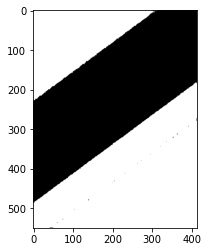

In [38]:
ret,thresh1 = cv2.threshold(img_gray,thresh=img.max()/2,maxval = 255,
             type = cv2.THRESH_BINARY_INV)
print(ret)
plt.imshow(thresh1,cmap='gray')

127.0


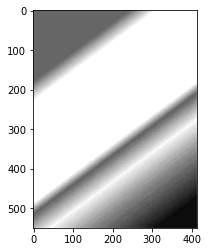

In [39]:
ret,thresh1 = cv2.threshold(img_gray,thresh=img.max()/2,maxval = 255,
             type = cv2.THRESH_TRUNC)
print(ret)
plt.imshow(thresh1,cmap='gray')

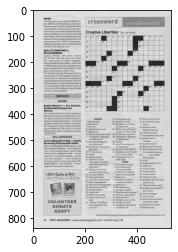

In [40]:
img = cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/crossword.jpg',0)
plt.imshow(img,cmap='gray')

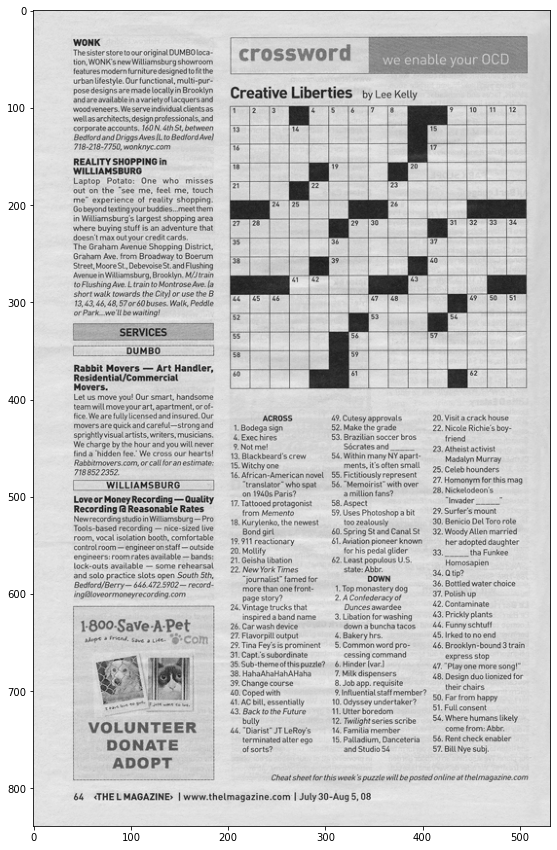

In [41]:
def show_img(img):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap = 'gray')
show_img(img)

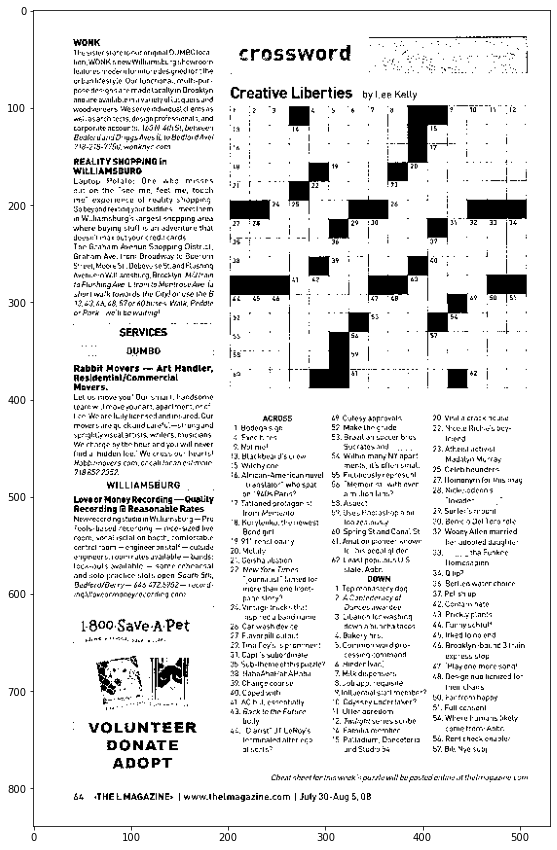

In [42]:
# cv2.THRESH_BINARY
# cv2.THRESH_BINARY_INV
# cv2.THRESH_TRUNC
# cv2.THRESH_TOZERO
# cv2.THRESH_TOZERO_INV

# Syntax: cv2.threshold(source, thresholdValue, maxVal, thresholdingTechnique)

# Parameters:
# -> source: Input Image array (must be in Grayscale).
# -> thresholdValue: Value of Threshold below and above which pixel values will change accordingly.
# -> maxVal: Maximum value that can be assigned to a pixel.
# -> thresholdingTechnique: The type of thresholding to be applied.

ret,thr1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY)
show_img(thr1)

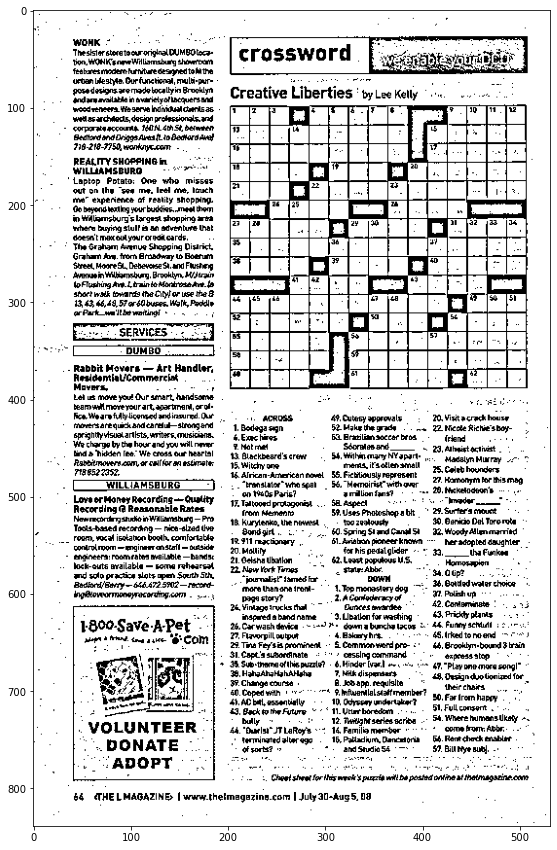

In [43]:
# Adaptive Method - It decides how thresholding value is calculated.
# cv2.ADAPTIVE_THRESH_MEAN_C : threshold value is the mean of neighbourhood area.
# cv2.ADAPTIVE_THRESH_GAUSSIAN_C : threshold value is the weighted sum of neighbourhood values where weights are a gaussian window.
# Block Size - It decides the size of neighbourhood area.

# Syntax: cv2.adaptiveThreshold(source, maxVal, adaptiveMethod, thresholdType, blocksize, constant)

# Parameters:
# -> source: Input Image array(Single-channel, 8-bit or floating-point)
# -> maxVal: Maximum value that can be assigned to a pixel.
# -> adaptiveMethod: Adaptive method decides how threshold value is calculated.
#  cv2.ADAPTIVE_THRESH_MEAN_C: Threshold Value = (Mean of the neighbourhood area values – constant value). In other words, it is the mean of the blockSize×blockSize neighborhood of a point minus constant.
# C - It is just a constant which is subtracted from the mean or weighted mean calculated.

thr2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,
                            cv2.THRESH_BINARY,11,9)
show_img(thr2)

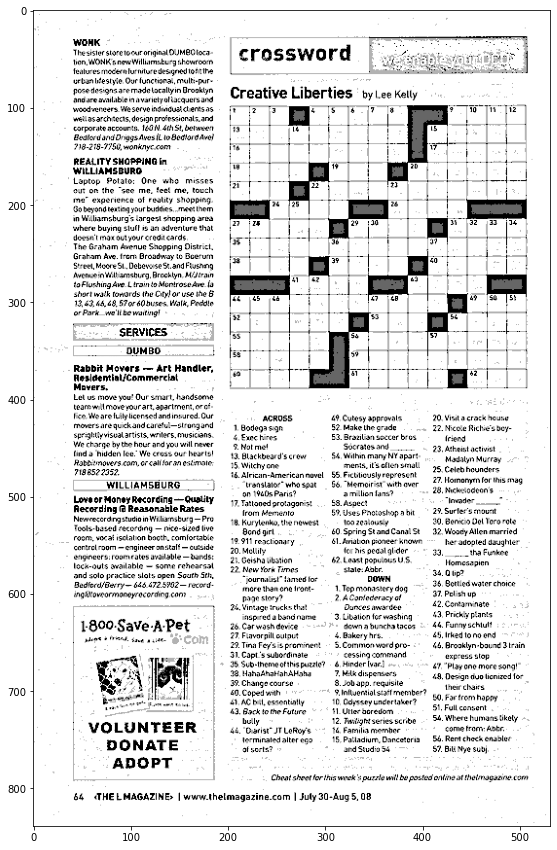

In [44]:

# >>> x = np.uint8([250])
# >>> y = np.uint8([10])
# >>> print cv2.add(x,y) # 250+10 = 260 => 255
# >>> print x+y          # 250+10 = 260 % 256 = 4

# dst = \alpha \cdot img1 + \beta \cdot img2 + \gamma
# Here \gamma is taken as zero.
# img1 = cv2.imread('ml.png')
# img2 = cv2.imread('opencv_logo.jpg')
# dst = cv2.addWeighted(img1,0.7,img2,0.3,0)
# cv2.imshow('dst',dst)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

blended = cv2.addWeighted(thr1,0.7,thr2,0.4,0)
show_img(blended)

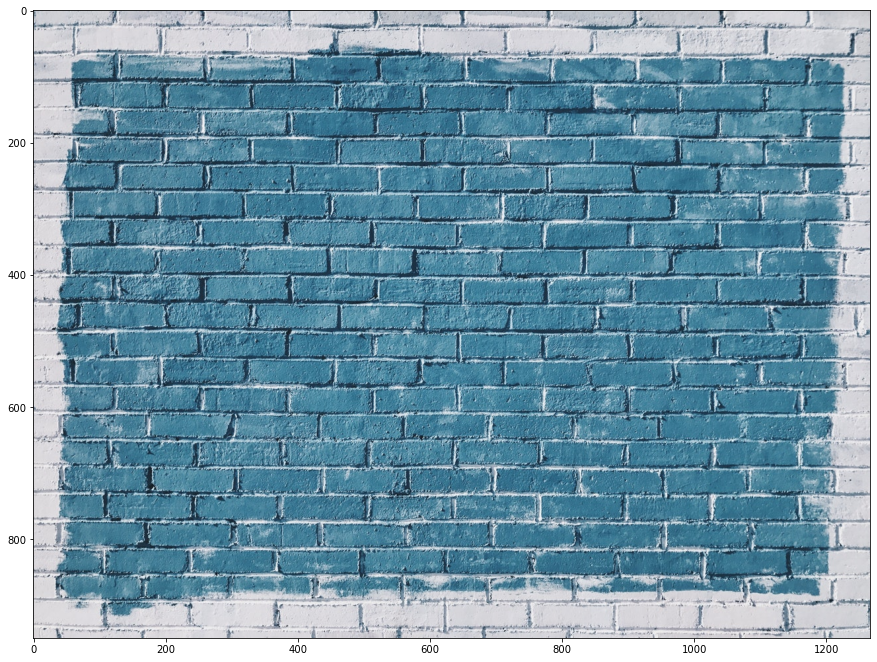

In [45]:
# Class 4 Blurring and Smoothing
# Blurring/Smoothing is combined with edge detection
# Edge detection algorithms detect too many edges when shown a high resolution image without any blurring 
# Methods
# Gamma Correction: can be applied to an image to make it appear brighter or darker depending on the Gamma value chosen
# Kernel Based Filters can be applied over an image to produce a variet of effects

import cv2
import matplotlib.pyplot as plt
import numpy as np

def load_img():
    img = cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/bricks.jpg').astype(np.float32) / 255
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    return img

def show_img(img):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap = 'gray')

i = load_img()
show_img(i)

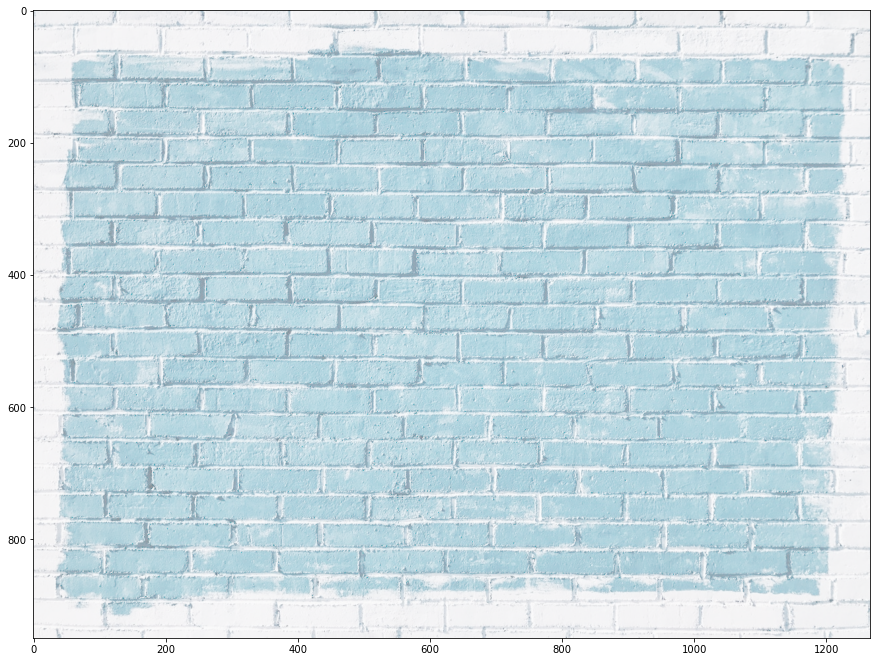

In [46]:
gamma = 1/4
# numpy.power(arr1, arr2, out = None, where = True, casting = ‘same_kind’, order = ‘K’, dtype = None) :

# arr1     : [array_like]Input array or object which works as base.
# arr2     : [array_like]Input array or object which works as exponent. 
# out      : [ndarray, optional]Output array with same dimensions as Input array,  placed with result.
# **kwargs : Allows you to pass keyword variable length of argument to a function.  It is used when we want to handle named argument in a function.
# where    : [array_like, optional]True value means to calculate the universal functions(ufunc) at that position, False value means to leave the  value in the output alone.

result = np.power(i,gamma)
show_img(result)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


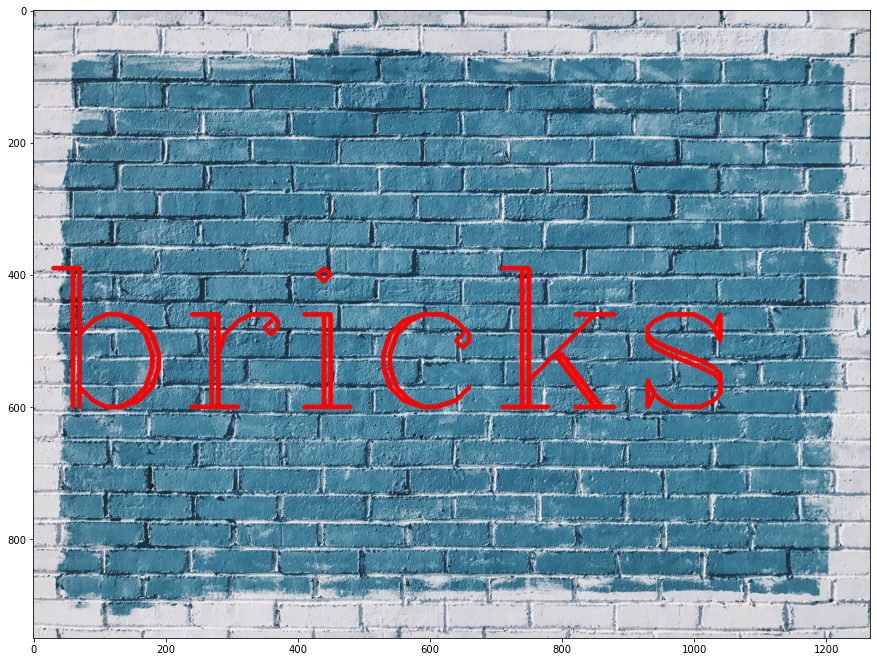

In [47]:
# cv::HersheyFonts {
#   cv::FONT_HERSHEY_SIMPLEX = 0,
#   cv::FONT_HERSHEY_PLAIN = 1,
#   cv::FONT_HERSHEY_DUPLEX = 2,
#   cv::FONT_HERSHEY_COMPLEX = 3,
#   cv::FONT_HERSHEY_TRIPLEX = 4,
#   cv::FONT_HERSHEY_COMPLEX_SMALL = 5,
#   cv::FONT_HERSHEY_SCRIPT_SIMPLEX = 6,
#   cv::FONT_HERSHEY_SCRIPT_COMPLEX = 7,
#   cv::FONT_ITALIC = 16

# Syntax: cv2.putText(image, text, org, font, fontScale, color[, thickness[, lineType[, bottomLeftOrigin]]])

img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))

In [48]:
kernel = np.ones((5,5),dtype=np.float32) / 25
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


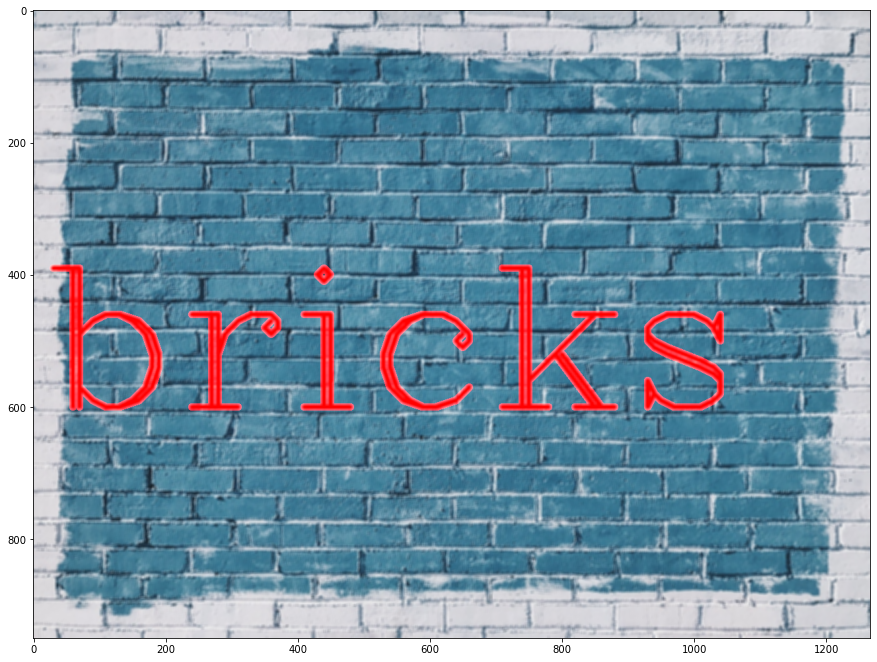

In [49]:
# filter2D(src, dst, ddepth, kernel)
# src − A Mat object representing the source (input image) for this operation.
# dst − A Mat object representing the destination (output image) for this operation.
# ddepth − A variable of the type integer representing the depth of the output image.
# kernel − A Mat object representing the convolution kernel.

dst = cv2.filter2D(img,-1,kernel)
show_img(dst)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


reset


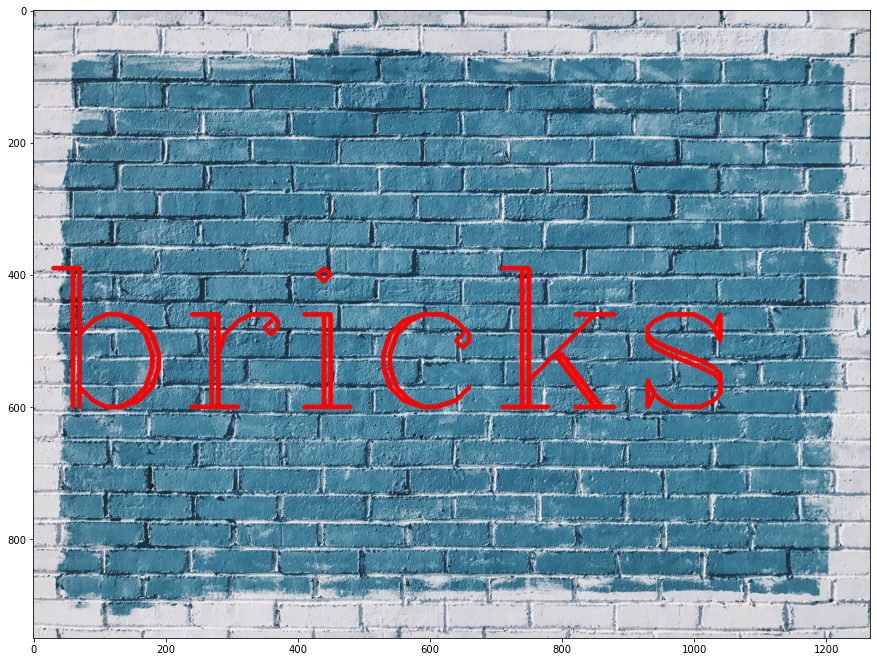

In [50]:
img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))
print('reset')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


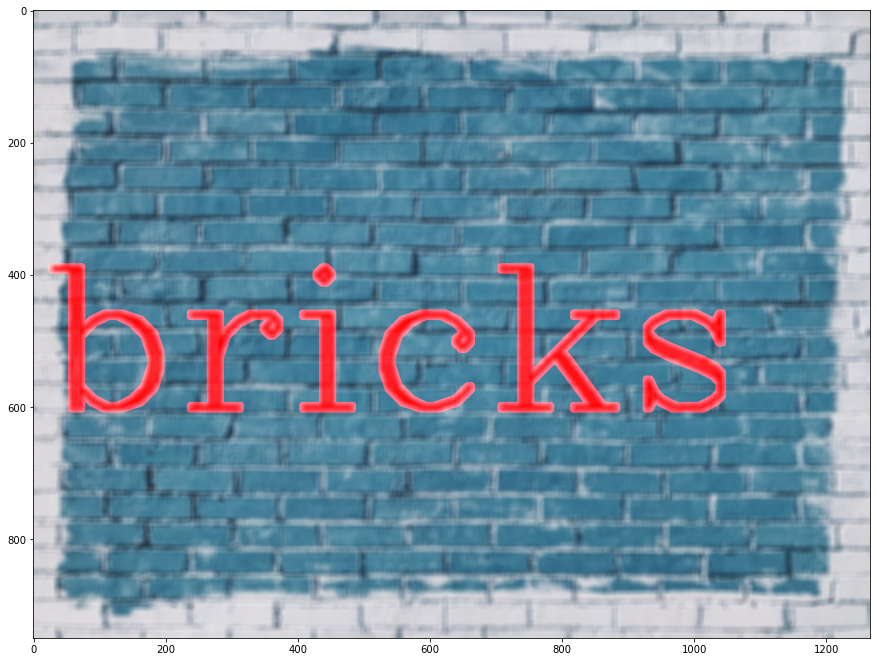

In [51]:
# import cv2
# import numpy as np
# from matplotlib import pyplot as plt

# img = cv2.imread('opencv_logo.png')

# blur = cv2.blur(img,(5,5))

# plt.subplot(121),plt.imshow(img),plt.title('Original')
# plt.xticks([]), plt.yticks([])
# plt.subplot(122),plt.imshow(blur),plt.title('Blurred')
# plt.xticks([]), plt.yticks([])
# plt.show()

# Syntax: cv2.blur(src, ksize[, dst[, anchor[, borderType]]])
# Parameters:
# src: It is the image whose is to be blurred.
# ksize: A tuple representing the blurring kernel size.
# dst: It is the output image of the same size and type as src.
# anchor: It is a variable of type integer representing anchor point and it’s default value Point is (-1, -1) which means that the anchor is at the kernel center.
# borderType: It depicts what kind of border to be added. It is defined by flags like cv2.BORDER_CONSTANT, cv2.BORDER_REFLECT, etc
# Return Value: It returns an image.


blurred = cv2.blur(img,ksize = (10,10))
show_img(blurred)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


reset


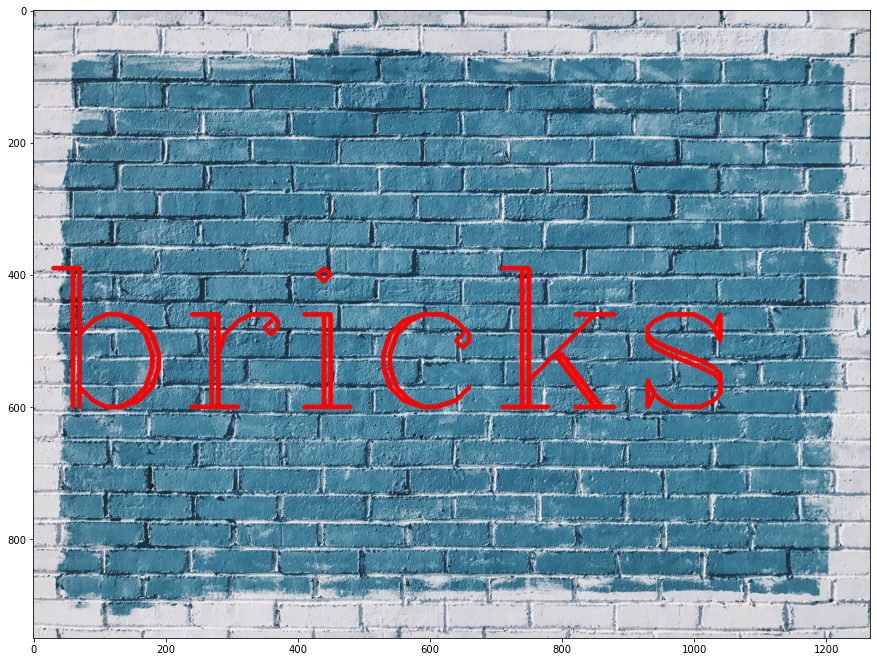

In [52]:
img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))
print('reset')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


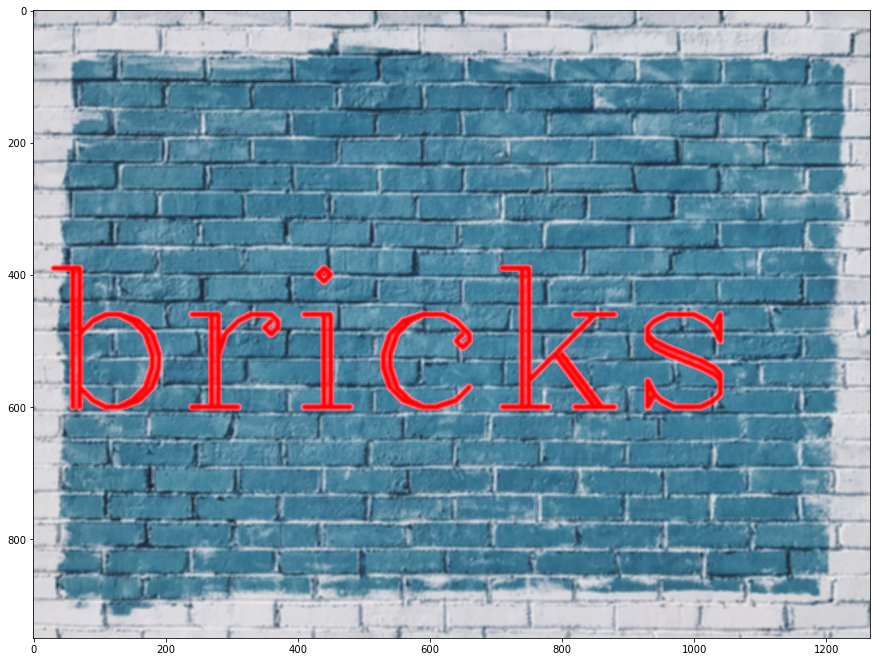

In [53]:
# dst = cv.GaussianBlur(src, ksize, sigmaX[, dst[, sigmaY[, borderType=BORDER_DEFAULT]]] )
gaussian_blur = cv2.GaussianBlur(img,(5,5),10)
show_img(gaussian_blur)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


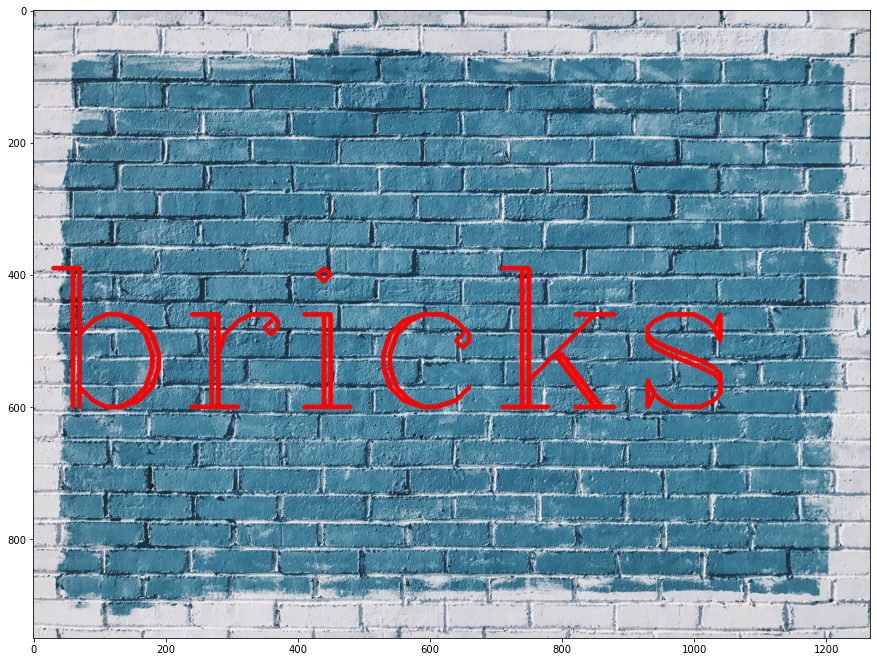

In [54]:
img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


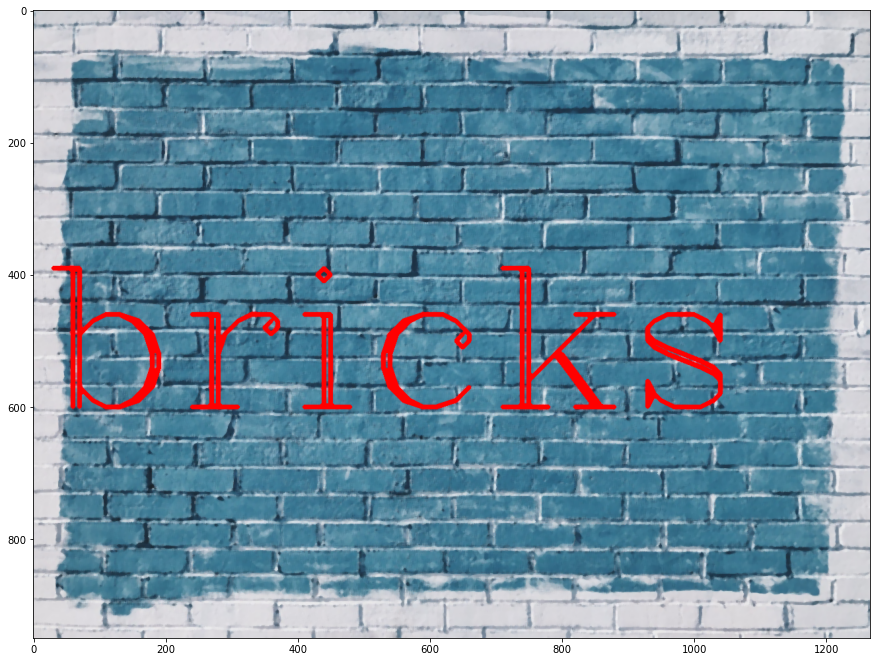

In [55]:
# medianBlur(src, dst, ksize)print('reset')
median_blur = cv2.medianBlur(img,5)
show_img(median_blur)

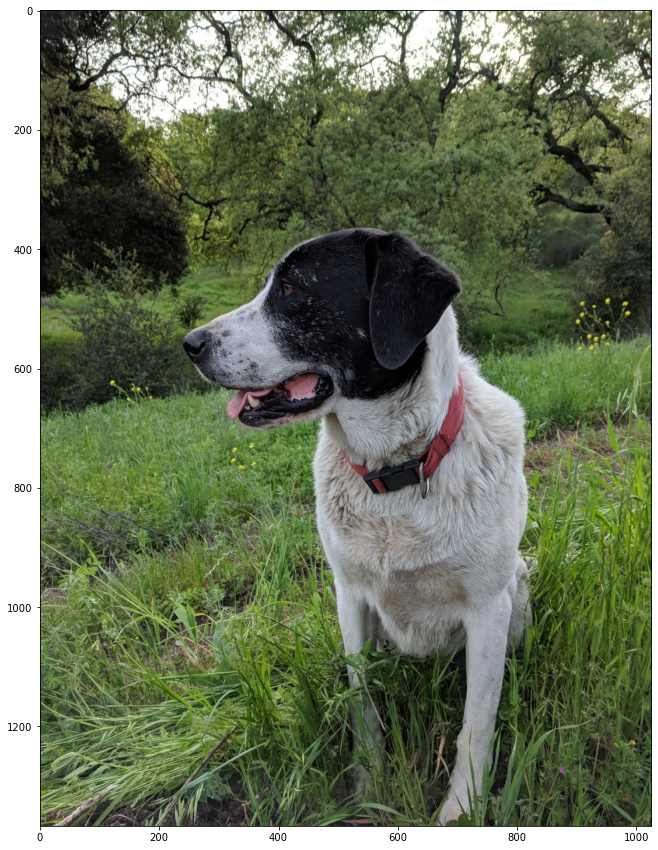

In [56]:
img = cv2.cvtColor(cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/sammy.jpg'),cv2.COLOR_BGR2RGB)
show_img(img)

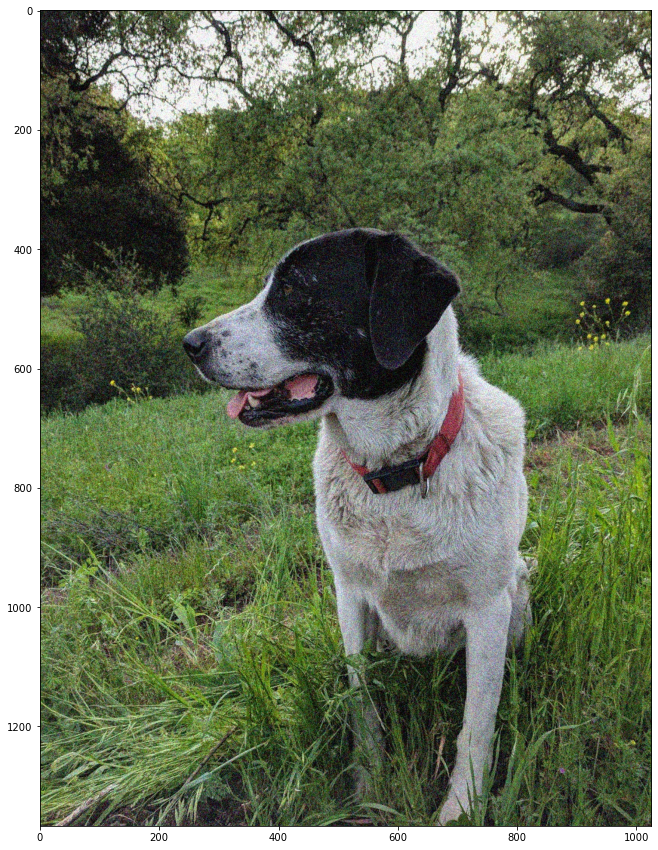

In [57]:
noisy_img = cv2.imread('C:/Users/vasukisriram/Downloads/Python OpenCV DL # DATA GH/Data/sammy_noise.jpg')
show_img(noisy_img)

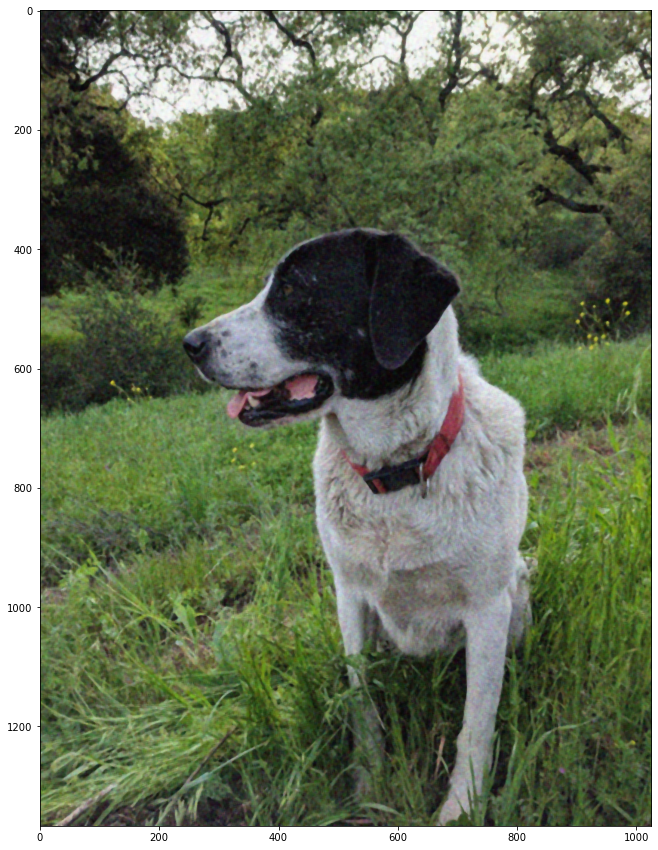

In [58]:
median = cv2.medianBlur(noisy_img,5)
show_img(median)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


reset


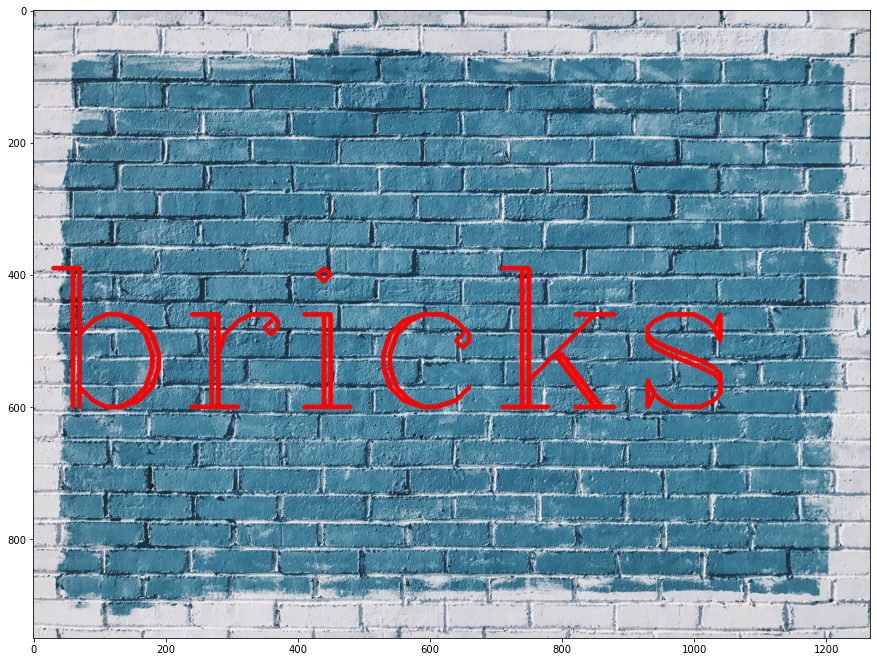

In [59]:
img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))
print('reset')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


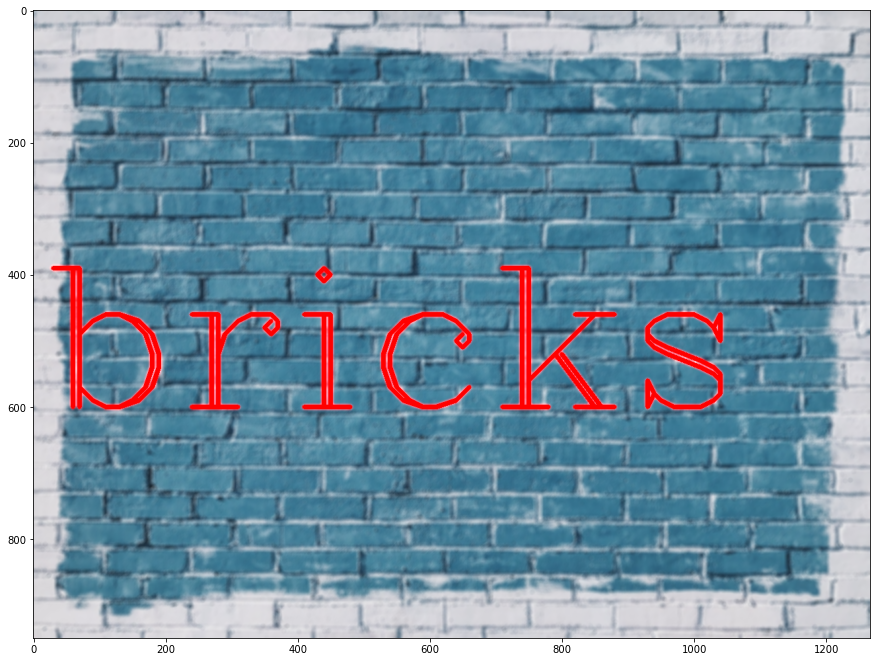

In [60]:
# A bilateral filter is used for smoothening images and reducing noise, while preserving edges
blur = cv2.bilateralFilter(img,9,75,75)
show_img(blur)